# Object Detection Minimal Example

The standard instructions are not reliable.  Follow these:

https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/tf2.md

These will install tensorflow and make it match with the models.

Make sure your protoc is up to date.

You may have to add the models to the path, explicitly, as I've done below.

## Imports and Setup

In [1]:
import tensorflow as tf
tf.__version__

'2.3.1'

In [2]:
import sys
sys.path.append("/media/jsaxon/brobdingnag/projects/urban_vision/models")

In [3]:
import matplotlib
import matplotlib.pyplot as plt

import io
import scipy.misc
import numpy as np
from six import BytesIO
from PIL import Image, ImageDraw, ImageFont

import tensorflow as tf

from object_detection.utils import label_map_util
from object_detection.utils import config_util
from object_detection.utils import visualization_utils as viz_utils
from object_detection.builders import model_builder

import cv2

cv2pil = lambda x : Image.fromarray(cv2.cvtColor(x, cv2.COLOR_BGR2RGB))
np2pil = lambda x : Image.fromarray(x)

%matplotlib inline

## Utilities

In [4]:
# @title Choose the model to use, then evaluate the cell.
MODELS = {'centernet_with_keypoints': 'centernet_hourglass104_512x512_kpts_coco17_tpu-32', 
          'centernet_without_keypoints': 'centernet_hourglass104_512x512_coco17_tpu-8'}

model_display_name = 'centernet_without_keypoints' # @param ['centernet_with_keypoints', 'centernet_without_keypoints']
model_name = MODELS[model_display_name]

### Build a detection model and load pre-trained model weights

This sometimes takes a little while, please be patient!

In [5]:
# Download the checkpoint and put it into models/research/object_detection/test_data/

# !wget http://download.tensorflow.org/models/object_detection/tf2/20200711/centernet_hg104_512x512_coco17_tpu-8.tar.gz
# !tar -xf centernet_hg104_512x512_coco17_tpu-8.tar.gz
# !mv centernet_hg104_512x512_coco17_tpu-8/checkpoint models/research/object_detection/test_data/

In [6]:
import os

pipeline_config = os.path.join('models/research/object_detection/configs/tf2/', model_name + '.config')
model_dir       = 'models/research/object_detection/test_data/checkpoint/'

# Load pipeline config and build a detection model
configs = config_util.get_configs_from_pipeline_file(pipeline_config)

model_config = configs['model']
detection_model = model_builder.build(model_config = model_config, is_training=False)

# Restore checkpoint
ckpt = tf.compat.v2.train.Checkpoint(model=detection_model)
ckpt.restore(os.path.join(model_dir, 'ckpt-0')).expect_partial()

def get_model_detection_function(model):
    """Get a tf.function for detection."""
  
    @tf.function
    def detect_fn(image):
        """Detect objects in image."""
    
        image, shapes = model.preprocess(image)
        prediction_dict = model.predict(image, shapes)
        detections = model.postprocess(prediction_dict, shapes)
    
        return detections, prediction_dict, tf.reshape(shapes, [-1])
  
    return detect_fn

detect_fn = get_model_detection_function(detection_model)

# Load label map data (for plotting).

Label maps correspond index numbers to category names, so that when our convolution network predicts `5`, we know that this corresponds to `airplane`.  Here we use internal utility functions, but anything that returns a dictionary mapping integers to appropriate string labels would be fine.

This is a joke -- the examples are totally fucked.

In [7]:
# label_map_path = configs['eval_input_config'].label_map_path
label_map_path = 'models/research/object_detection/data/mscoco_label_map.pbtxt'

label_map = label_map_util.load_labelmap(label_map_path)
categories = label_map_util.convert_label_map_to_categories(
                                      label_map,
                                      max_num_classes=label_map_util.get_max_label_map_index(label_map),
                                      use_display_name=True)

category_index = label_map_util.create_category_index(categories)
label_map_dict = label_map_util.get_label_map_dict(label_map, use_display_name=True)

## Load some frames of a film.

In [8]:
cap = cv2.VideoCapture("/media/jsaxon/brobdingnag/data/cv/vid/burnham/55/20200927_143601.MOV")

img = []

for x in range(100):
    for xi in range(10):
        ret, frame = cap.read()
        
    img.append(cv2pil(frame))
    
cap.release()

## Utility function to show detections through cv2.

In [15]:
color_cat = [(0, 0, 255), (0, 255, 255)]

def paint_detections(img, detections, categories = ["person", "bicycle"], thresh = 0.3, category_offset = 1):
    
    thresh = 0.3

    img = cv2.cvtColor(img.copy(), cv2.COLOR_RGB2BGR)
    height, width, _ = img.shape

    scores  = detections['detection_scores'] [0]
    classes = detections['detection_classes'][0]
    boxes   = detections['detection_boxes']  [0]

    keep_categories = [label_map_dict[k] - category_offset
                       for k in categories]

    display = np.isin(classes, keep_categories) & (scores > thresh)
    
    boxes   = boxes  [display]
    scores  = scores [display]
    classes = classes[display]

    for box, cat in zip(boxes, classes):
        
        ymin, xmin, ymax, xmax = np.array(box)
        
        cv2.rectangle(img, tuple((int(xmin * width), int(ymin * height))),
                           tuple((int(xmax * width), int(ymax * height))),
                      color_cat[cat], 2)

    return img



## And finally, the detections. 

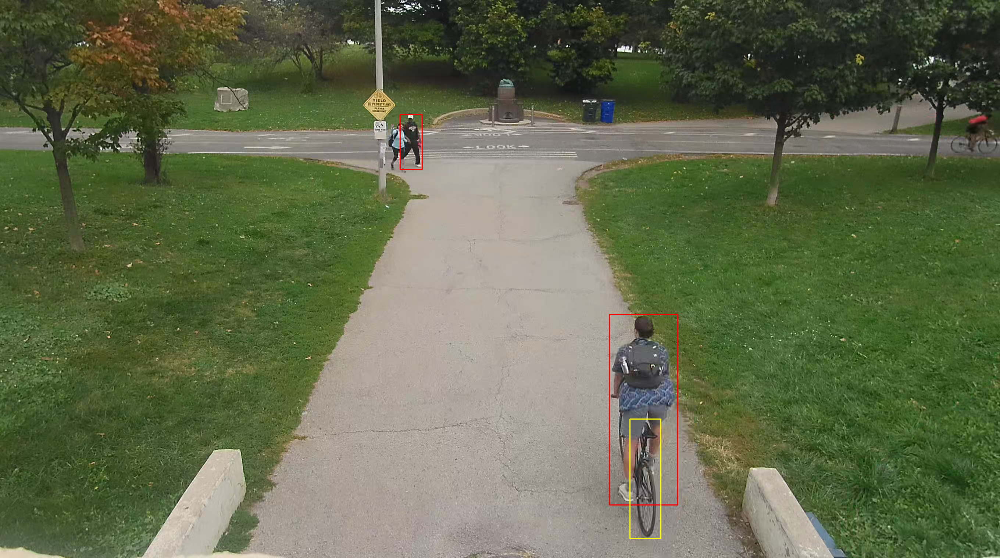

0


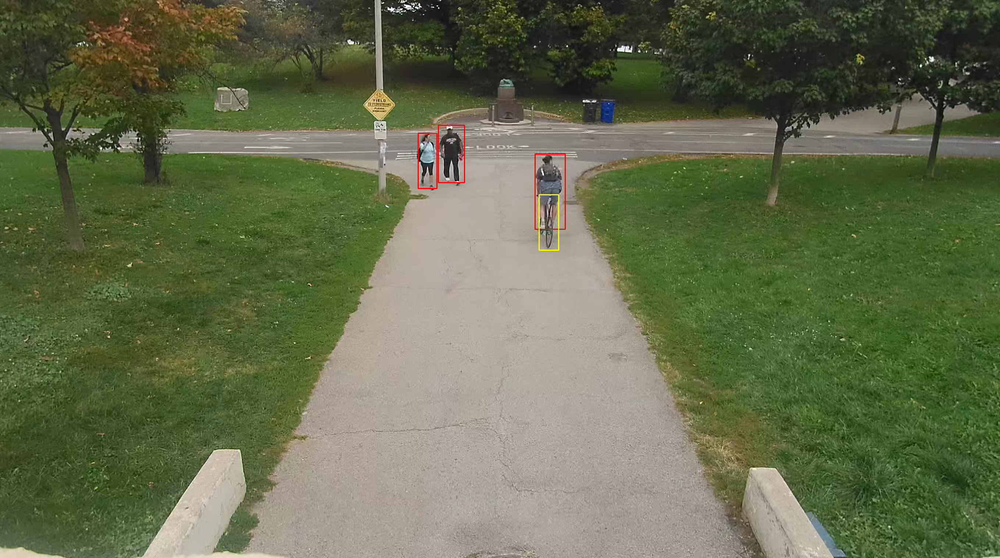

1


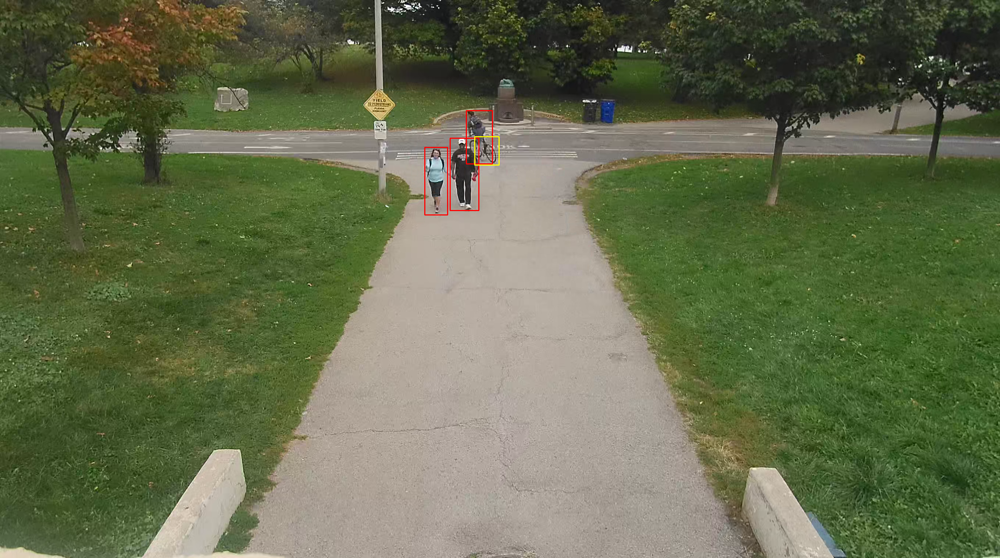

2


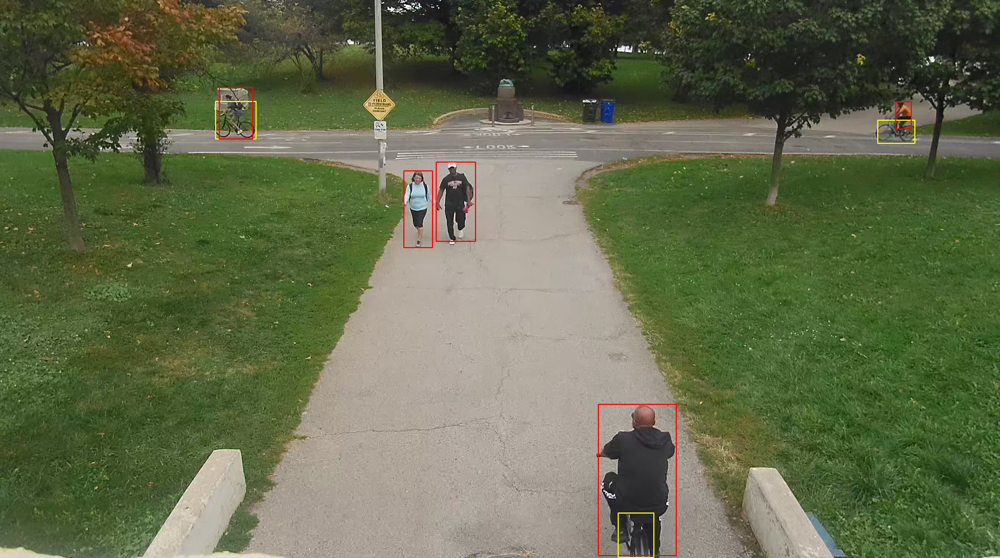

3


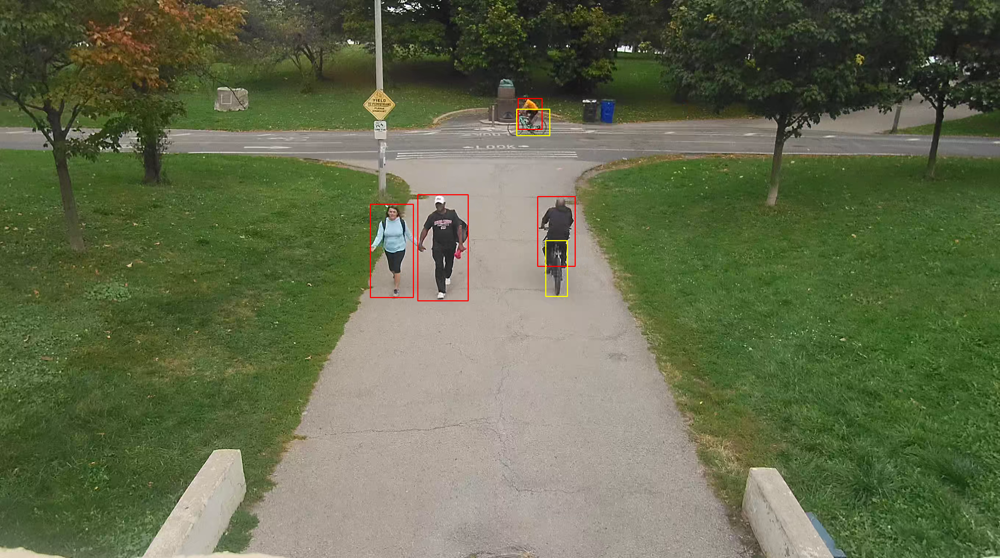

4


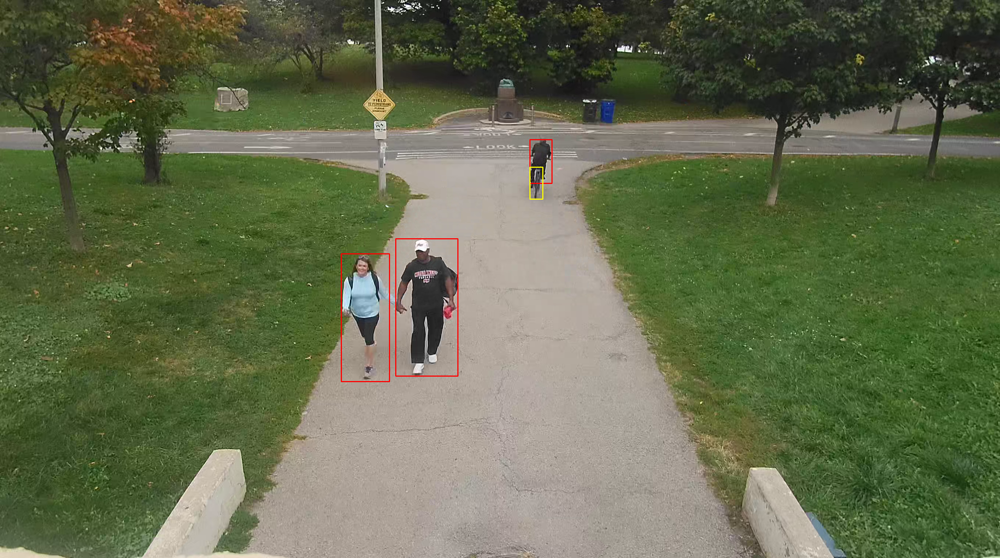

5


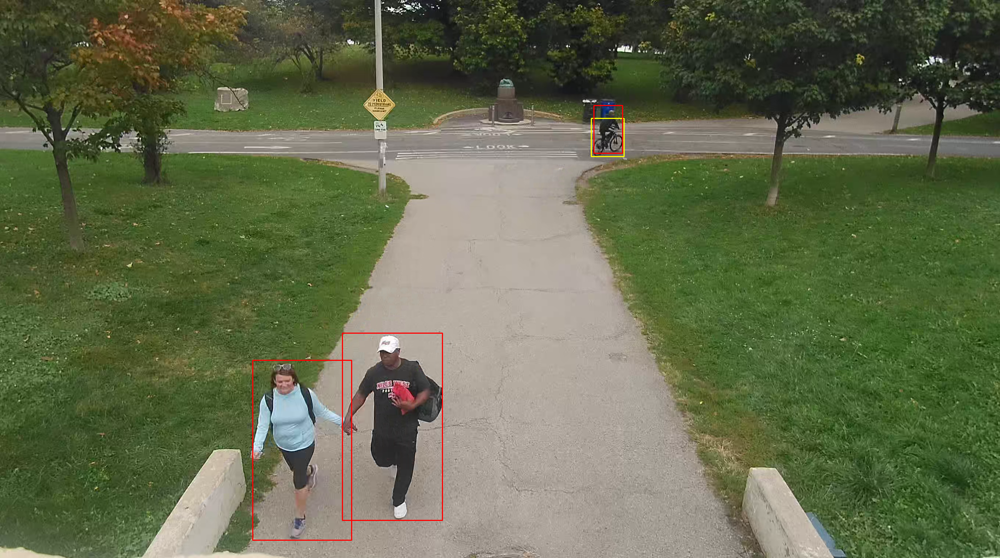

6


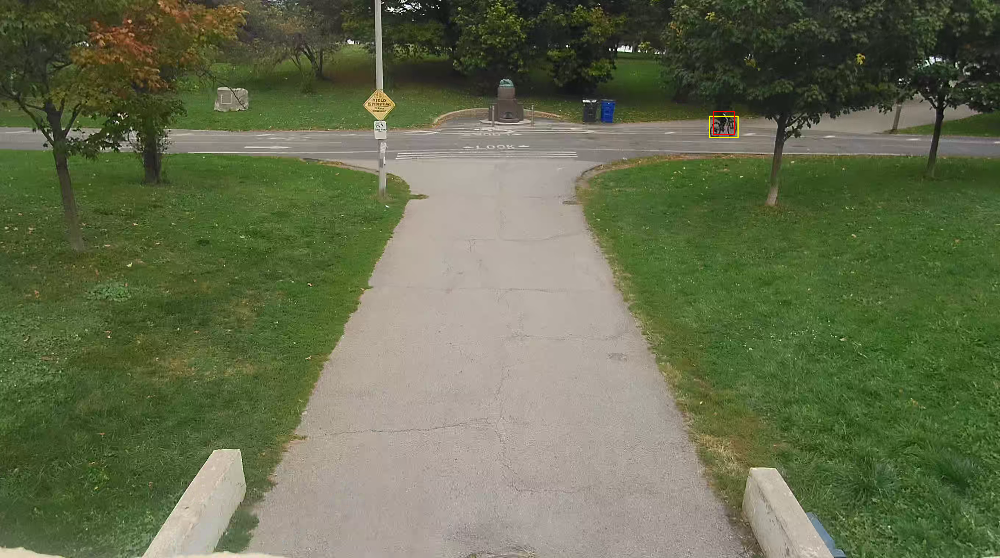

7


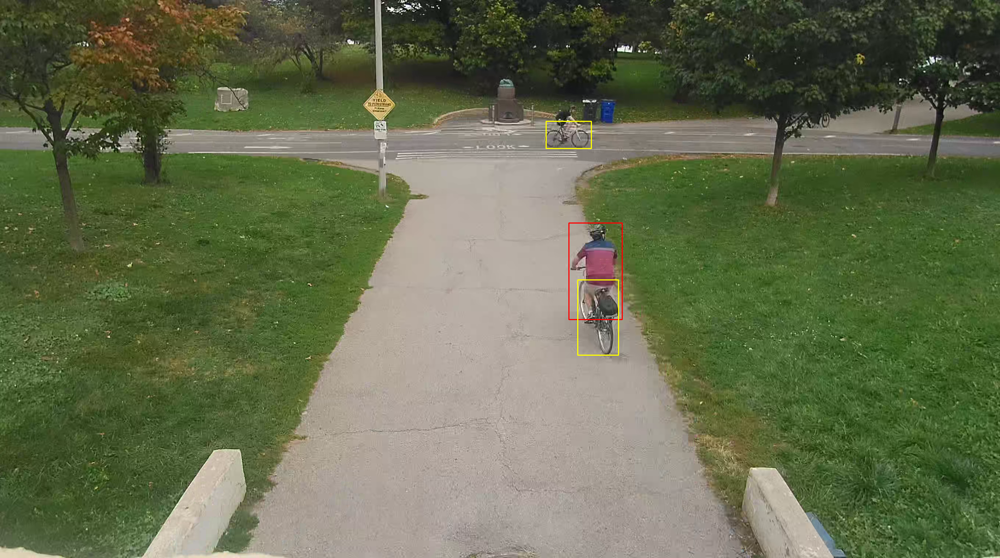

8


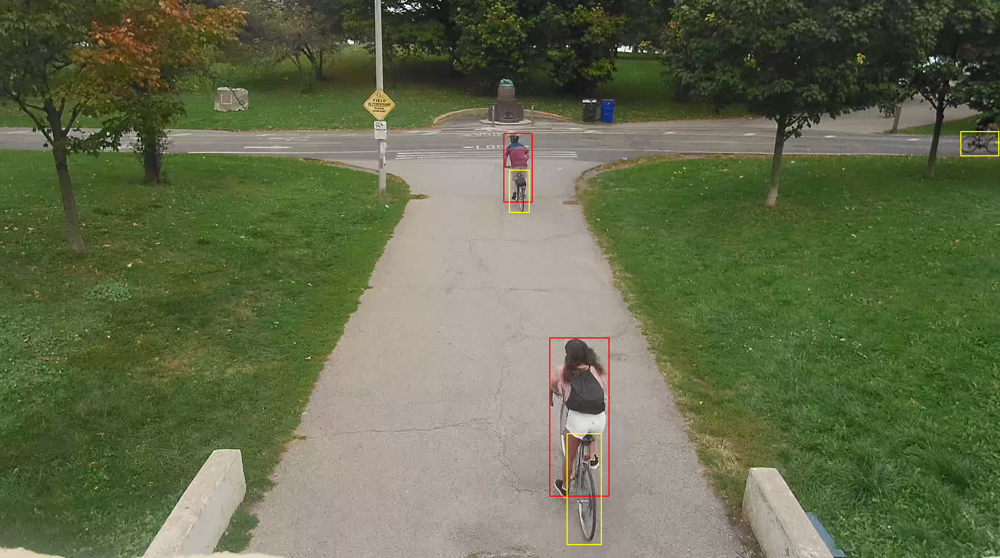

9


In [19]:
for ix, i in enumerate(img[:10]):

    np_img = np.array(i)
    tf_img = tf.convert_to_tensor(np.expand_dims(np_img, 0), dtype=tf.float32)

    detections, predictions_dict, shapes = detect_fn(tf_img)

    img_det = paint_detections(np_img, detections, thresh = 0.5)
    display(cv2pil(img_det))
    print(ix)
    